Summary:

Final model is a single layer covolutional LSTM which predicts the lightning strike locations and counts in time. Main reason, is from research papers in references - storm evolution is spatiotemporal, and ConvLSTM is proven to capture these types of dynamics.

In short, the model applied a 3x3 convolution for each frame input which has 4 channels. This produces a feature map which I fed into the ConvLSTMcell - across 36 frames, it keeps track of the hidden state and cell state.

Next, the crucial part:

hidden state at each frame branches out into 2:
1)a probability map head - 1x1 convolution and sigmoid activaiton function resulting in a pixel wise probability of a lightinging strike
2)a count head - it pools the hidden features in one scalar per frame, which is rescaled by 'count_scale'. resulting in the predicted total number of strikes per frame.

Loss function, 2 main parts:
1)BCE loss - comaparing predicted probability map against the binary mask of strike locations. However, due to class imbalance, the weighting introduced icnreases how important a positive strike pixel is.
2)Log MSE for counts - logging the predicted and true strike counts then mse. As strikes may (and do from our eda) vary a lot each frames - this helps us to still comapre.

Training:

used 30% of events. each mini batch has 2 events. AdamW with a standard 1e-3 learning rate is used, but I changed the count_scale's learning rate to 2e-3. Alos included gradient clipping to help with stabilsation.

Outcome:

2 outputs are possible, a probability map, frame by frame and the count.

I implemented the 3d chamfer metric too.

Other?

I looked at other models, like the U-Net, as I used it in my last assignment. But it's not so good for moving images - doesn't explicity model temporal dependencies or any hiddens tates over frames as each frame is proccesed indepnedetly. I am sure some modifiation could be made to it, as generally u-net is reliable for many tasks, but i couldnt figure it out. overall, u-net wasn't good at localising and couting stirkes over time.

Overall, performance was fine. There are no 'delayed' strikes like in the u-net. But sometimes, this was an issue with the loss function, the model still preidcts lighting even if the truth has no lightning. I looked at other ways to fix, eg using focal loss function, but it made th overall results much much worse. Instead, in general our loss function is good enough without overcomplicating or having too many layers.


imports

In [ ]:
import os
import io
import numpy as np
import h5py
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import pandas as pd
import PIL
import IPython
from torch.utils.data import Dataset, DataLoader
from huggingface_hub import hf_hub_download
from sklearn.model_selection import train_test_split
import math
import itertools

download data

In [ ]:
hf_hub_download(
    repo_id="benmoseley/ese-dl-2024-25-group-project",
    filename="train.h5",
    repo_type="dataset",
    local_dir="data"
)
hf_hub_download(
    repo_id="benmoseley/ese-dl-2024-25-group-project",
    filename="events.csv",
    repo_type="dataset",
    local_dir="data"
)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


train.h5:   0%|          | 0.00/10.7G [00:00<?, ?B/s]

events.csv:   0%|          | 0.00/782k [00:00<?, ?B/s]

'data/events.csv'

In [ ]:
df = pd.read_csv("data/events.csv", parse_dates=["start_utc"])
display(df.head())

,id,img_type,start_utc,llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon,proj,height_m,width_m
0,S778114,ir069,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.94459,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
1,S778114,ir107,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.94459,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
2,S778114,lght,NaT,32.781533,-92.631841,35.94459,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
3,S778114,vil,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.94459,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0
4,S778114,vis,2018-08-20 19:50:00+00:00,32.781533,-92.631841,35.94459,-88.134075,+proj=laea +lat_0=38 +lon_0=-98 +units=m +a=63...,384000.0,384000.0


function to load event from hdf5 and an id

In [ ]:
def load_event(event_id):
    """
    Load event from HDF5 given an ID.
    """
    with h5py.File("data/train.h5", "r") as f:
        ev = {k: f[event_id][k][:] for k in ['vis','ir069','ir107','vil','lght']}
    return ev

# see shapes
ex_id = df['id'].iloc[0]
ex_event = load_event(ex_id)
for k, arr in ex_event.items():
    print(f"{k}: shape={arr.shape}, dtype={arr.dtype}")

vis: shape=(384, 384, 36), dtype=int16
ir069: shape=(192, 192, 36), dtype=int16
ir107: shape=(192, 192, 36), dtype=int16
vil: shape=(384, 384, 36), dtype=uint8
lght: shape=(38777, 5), dtype=float32


In [ ]:
def get_subset_ids(df, fraction=0.02):
    """
    Return random subset of IDs from df.
    """
    u = df['id'].unique()
    n = int(len(u)*fraction)
    return np.random.choice(u,n,replace=False)

custom dataset

In [ ]:
class LightningDataset(Dataset):
    """
    Load X and y for each event.
    """
    def __init__(self, event_ids, h5_file='data/train.h5'):
        self.event_ids = event_ids
        self.h5_file = h5_file

    def __len__(self):
        return len(self.event_ids)

    def process_lightning_data(self, lght_data, img_size=128):
        """
        Make strike maps + frame counts.
        """
        frame_maps = torch.zeros((36, img_size, img_size))
        strike_counts = torch.zeros(36)
        for strike in lght_data:
            t, _, _, x384, y384 = strike
            frm = int(np.round(t/300.0))
            if 0<=frm<36:
                xx = int(x384*img_size/384.)
                yy = int(y384*img_size/384.)
                if 0<=xx<img_size and 0<=yy<img_size:
                    frame_maps[frm, yy, xx]+=1.
                    strike_counts[frm]+=1.
        return frame_maps, strike_counts

    def process_image(self, arr):
        """
        Rearrange + resize to (36,128,128).
        """
        t = torch.from_numpy(arr.transpose(2,0,1)).float()
        t = F.interpolate(t.unsqueeze(0),(128,128),mode='bilinear',align_corners=False)
        return t.squeeze(0)

    def __getitem__(self, idx):
        ev_id = self.event_ids[idx]
        with h5py.File(self.h5_file,'r') as f:
            g = f[ev_id]
            vis   = g['vis'][:]
            ir069 = g['ir069'][:]
            ir107 = g['ir107'][:]
            vil   = g['vil'][:]
            lght  = g['lght'][:]
        vis   = self.process_image(vis)
        ir69  = self.process_image(ir069)
        ir107 = self.process_image(ir107)
        vil   = self.process_image(vil)

        vis   = (vis - vis.mean())/(vis.std()+1e-6)
        ir69  = (ir69 - ir69.mean())/(ir69.std()+1e-6)
        ir107 = (ir107 - ir107.mean())/(ir107.std()+1e-6)
        vil   = vil/255.

        vis   = vis.unsqueeze(1)
        ir69  = ir69.unsqueeze(1)
        ir107 = ir107.unsqueeze(1)
        vil   = vil.unsqueeze(1)
        x = torch.cat([vis,ir69,ir107,vil], dim=1)

        maps, counts = self.process_lightning_data(lght)
        return x, (maps, counts)

In [ ]:
def custom_collate_fn(batch):
    """
    Combine batch.
    """
    xs,maps,counts = [],[],[]
    for b in batch:
        xs.append(b[0])
        maps.append(b[1][0])
        counts.append(b[1][1])
    return torch.stack(xs,0),(torch.stack(maps,0), torch.stack(counts,0))

custom loss BCE and MSE

In [ ]:
def custom_loss(pred_maps, pred_counts, target_maps, target_counts):
    """
    Simple BCE + log-space MSE for counts.
    """
    pos = (target_maps>0).float()
    neg = 1-pos
    npos = pos.sum()
    nneg = neg.sum()
    if npos>0:
        pos*= (nneg/(npos+1e-6))
    w = pos*3+neg
    bce = F.binary_cross_entropy(pred_maps,(target_maps>0).float(),weight=w)
    eps=1e-6
    lp = torch.log(pred_counts+eps)
    lt = torch.log(target_counts+eps)
    cl = F.mse_loss(lp,lt)
    return bce+cl, bce, cl

In [ ]:
class ConvLSTMCell(nn.Module):
    """
    Single ConvLSTM cell.
    """
    def __init__(self, in_chans, hidden_chans, kernel_size=3, padding=1):
        super().__init__()
        self.in_chans = in_chans
        self.hidden_chans = hidden_chans
        self.conv = nn.Conv2d(in_chans+hidden_chans, 4*hidden_chans, kernel_size, padding=padding)

    def forward(self, x, hidden):
        h,c = hidden
        comb = torch.cat([x,h],1)
        gates = self.conv(comb)
        i,f,o,g = torch.split(gates, self.hidden_chans, dim=1)
        i = torch.sigmoid(i)
        f = torch.sigmoid(f)
        o = torch.sigmoid(o)
        g = torch.tanh(g)
        c2 = f*c + i*g
        h2 = o*torch.tanh(c2)
        return h2,c2

    def init_hidden(self,bsize,spatial):
        """
        Make hidden states
        """
        H,W = spatial
        d = next(self.parameters()).device
        return (torch.zeros(bsize,self.hidden_chans,H,W,device=d),
                torch.zeros(bsize,self.hidden_chans,H,W,device=d))

In [ ]:
class ConvLSTMModel(nn.Module):
    """
    Single-layer. Output prob map + counts per frame.
    """
    def __init__(self, in_chans=4, hidden_chans=64):
        super().__init__()
        self.hidden_chans = hidden_chans
        self.input_conv = nn.Conv2d(in_chans, hidden_chans, 3, padding=1)
        self.convlstm = ConvLSTMCell(hidden_chans, hidden_chans, 3, padding=1)
        self.prob_head = nn.Conv2d(hidden_chans,1,1)
        self.count_head = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(hidden_chans,1),
            nn.ReLU()
        )
        self.count_scale = nn.Parameter(torch.tensor([20.]))

    def forward(self, x):
        """
        x => (B,T,C,H,W).
        """
        B,T,C,H,W = x.shape
        h,c = self.convlstm.init_hidden(B,(H,W))
        pmaps, cvals = [], []
        for t in range(T):
            feat = F.relu(self.input_conv(x[:,t]))
            h,c = self.convlstm(feat,(h,c))
            pm = torch.sigmoid(self.prob_head(h))
            rc = self.count_head(h)*self.count_scale
            pmaps.append(pm)
            cvals.append(rc)
        pm_out = torch.stack(pmaps,1).squeeze(2)
        rc_out = torch.stack(cvals,1).squeeze(2)
        return pm_out, rc_out

training and evaluation

In [ ]:
def evaluate_model(model, loader, device='cuda'):
    """
    Evaluate with our custom loss.
    """
    model.eval()
    tl,tb,tc,nb = 0,0,0,0
    with torch.no_grad():
        for x,(mg,cg) in loader:
            x,mg,cg = x.to(device),mg.to(device),cg.to(device)
            pm,pc = model(x)
            loss,bce,cm = custom_loss(pm,pc,mg,cg)
            tl+=loss.item(); tb+=bce.item(); tc+=cm.item(); nb+=1
    if nb==0:return dict(total_loss=0,bce_loss=0,count_loss=0)
    return dict(
        total_loss=tl/nb,
        bce_loss=tb/nb,
        count_loss=tc/nb
    )

In [ ]:
def train_model(model, train_loader, val_loader, epochs=5, device='cuda'):
    """
    Train for 'epochs', keep best val.
    """
    model.to(device)
    cp = [model.count_scale]
    op = [p for p in model.parameters() if p is not model.count_scale]
    opt = torch.optim.AdamW([
        {'params':op,'lr':1e-3},
        {'params':cp,'lr':2e-3}
    ], weight_decay=1e-2)
    bestv = 1e9
    bestst = None
    for e in range(epochs):
        model.train()
        tl,tb,tc,nb = 0,0,0,0
        for bidx,(x,(mg,cg)) in enumerate(train_loader):
            x,mg,cg = x.to(device),mg.to(device),cg.to(device)
            opt.zero_grad()
            pm,pc = model(x)
            loss,bce,cl = custom_loss(pm,pc,mg,cg)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(),1.)
            opt.step()
            tl+=loss.item(); tb+=bce.item(); tc+=cl.item(); nb+=1
            if bidx%10==0:
                print(f"ep{e} b{bidx} loss={loss.item():.4f} bce={bce.item():.4f} c={cl.item():.4f}")
        valm = evaluate_model(model,val_loader,device)
        print(f"ep{e} trainLoss={tl/nb if nb else 0:.4f} valLoss={valm['total_loss']:.4f}")
        if valm['total_loss']<bestv:
            bestv=valm['total_loss']
            bestst=model.state_dict()
    if bestst:
        model.load_state_dict(bestst)
    return model

visualisations

In [ ]:
def make_gif(outfile, files, fps=10, loop=0):
    """
    Make gif from list of images.
    """
    from PIL import Image
    ims = [Image.open(f) for f in files]
    ims[0].save(outfile, format='gif', append_images=ims[1:], save_all=True,
                duration=int(1000/fps), loop=loop)
    return IPython.display.Image(filename=outfile)

In [ ]:
def get_lightning_locations(prob_map, count, threshold=0.3):
    """
    Return up to 'count' pixels with top prob above threshold.
    """
    binmap = (prob_map>threshold).float()
    ys,xs = torch.nonzero(binmap, as_tuple=True)
    if len(ys)==0:
        return np.zeros((0,2),float)
    probs = prob_map[ys,xs]
    idxs = torch.argsort(probs,descending=True)
    n = min(int(count), len(idxs))
    if n==0:return np.zeros((0,2),float)
    chosen = idxs[:n]
    coords = torch.stack([xs[chosen], ys[chosen]],dim=1)
    return coords.cpu().numpy()

In [ ]:
def visualise_comparison_with_probmap(eid, ev_data, pred_maps, pred_counts,
                                      output_gif=True, save_gif=False, threshold=0.3):
    """
    Compare GT vs predicted + probability map across frames.
    """
    B,T,H,W = pred_maps.shape
    def plot_frame(ti):
        t0,t1 = ti*300-150, ti*300+150
        l = ev_data['lght']
        times = l[:,0]
        mask = (times>=t0)&(times<t1)
        gt_xy = l[mask,3:5]
        c_gt = len(gt_xy)
        c_pred = int(pred_counts[0,ti].item())
        coords = get_lightning_locations(pred_maps[0,ti], c_pred, threshold)
        coords_384 = coords*(384./H)
        fig,axs=plt.subplots(1,3,figsize=(18,5))
        fig.suptitle(f"Event={eid}, Frame={ti}, True={c_gt}, Pred={c_pred}")
        vil_img = ev_data['vil'][:,:,ti]
        axs[0].imshow(vil_img,vmin=0,vmax=255,cmap='turbo')
        if c_gt>0: axs[0].scatter(gt_xy[:,0],gt_xy[:,1],marker='x',c='red')
        axs[1].imshow(vil_img,vmin=0,vmax=255,cmap='turbo')
        if len(coords_384)>0: axs[1].scatter(coords_384[:,0],coords_384[:,1],marker='x',c='blue')
        pm_up = F.interpolate(pred_maps[0,ti].unsqueeze(0).unsqueeze(0),(384,384),
                              mode='bilinear',align_corners=False).squeeze()
        im=axs[2].imshow(pm_up.cpu(),vmin=0,vmax=1,cmap='hot')
        plt.colorbar(im,ax=axs[2])
        for ax in axs: ax.set_xlim([0,384]); ax.set_ylim([384,0])
        tmp = f"_temp_{eid}_{ti}.png"
        plt.savefig(tmp,bbox_inches='tight',dpi=150)
        plt.close()

    if output_gif:
        for i in range(T): plot_frame(i)
        gifn = f"{eid}_comparison.gif"
        img = make_gif(gifn, [f"_temp_{eid}_{i}.png" for i in range(T)], fps=3)
        for i in range(T): os.remove(f"_temp_{eid}_{i}.png")
        IPython.display.display(img)
        if not save_gif: os.remove(gifn)
    else:
        plot_frame(0)
        plot_frame(T//2)
        plot_frame(T-1)

metrics

In [ ]:
def chamfer_distance_3d(A,B):
    """
    Compute Chamfer in 3D (time,x,y).
    """
    if len(A)==0 and len(B)==0: return 0.
    if len(A)==0: return np.sqrt((B**2).sum(1)).mean()
    if len(B)==0: return np.sqrt((A**2).sum(1)).mean()
    N,M=len(A),len(B)
    Aex,Bex = A[:,None,:],B[None,:,:]
    diff = Aex-Bex
    dsq = (diff**2).sum(2)
    ma = np.sqrt(dsq.min(1))
    mb = np.sqrt(dsq.min(0))
    return (ma.sum()+mb.sum())/(N+M)

In [ ]:
def compute_chamfer_for_batch(model, x_batch, event_lght, threshold=0.3, device='cuda'):
    """
    Chamfer dist for entire batch.
    """
    model.eval()
    B,T,C,H,W = x_batch.shape
    with torch.no_grad():
        pm,pc = model(x_batch.to(device))
    pm,pc = pm.cpu(), pc.cpu()
    out = []
    for b in range(B):
        preds=[]
        for t_idx in range(T):
            c_pred = int(pc[b,t_idx].item())
            coords = get_lightning_locations(pm[b,t_idx], c_pred, threshold)
            c384 = coords*(384./H)
            ts = t_idx*300.
            for (xx,yy) in c384:
                preds.append([ts,xx,yy])
        pred_pts = np.array(preds,float)
        gt_pts = event_lght[b][:,[0,3,4]]
        ch = chamfer_distance_3d(pred_pts, gt_pts)
        out.append(ch)
    return np.mean(out)

ep0 b0 loss=180.2797 bce=2.6928 c=177.5869
ep0 b10 loss=159.7801 bce=2.1106 c=157.6695
ep0 b20 loss=2.5939 bce=1.8628 c=0.7311
ep0 b30 loss=162.0132 bce=1.5329 c=160.4803
ep0 b40 loss=5.8035 bce=1.4891 c=4.3144
ep0 b50 loss=163.4157 bce=1.8076 c=161.6081
ep0 b60 loss=2.3313 bce=1.9032 c=0.4281
ep0 b70 loss=5.9619 bce=1.3115 c=4.6504
ep0 trainLoss=44.4467 valLoss=53.7753
Test BCE+Count: {'total_loss': 36.41283581405878, 'bce_loss': 1.596143761028846, 'count_loss': 34.816692437666156}
Chamfer S844198: 93.76
Chamfer S820316: 122.95
Chamfer S781158: 96.02
Chamfer S805239: 69.47
Chamfer S788678: 170.26
Chamfer S829441: 68.56
Chamfer S822243: 57.54
Chamfer S775451: 58.82
Chamfer S800483: 271.06
Chamfer S827374: 86.37
Chamfer S813625: 76.15
Chamfer S841230: 76.97
Chamfer S829342: 95.51
Chamfer S779848: 102.47
Chamfer S845655: 95.13
Chamfer S772435: 467.61
Chamfer S836827: 98.87
Chamfer S782602: 1190.96
Chamfer S830928: 113.98
Chamfer S785304: 79.22
Chamfer S842181: 98.14
Chamfer S834603: 5416

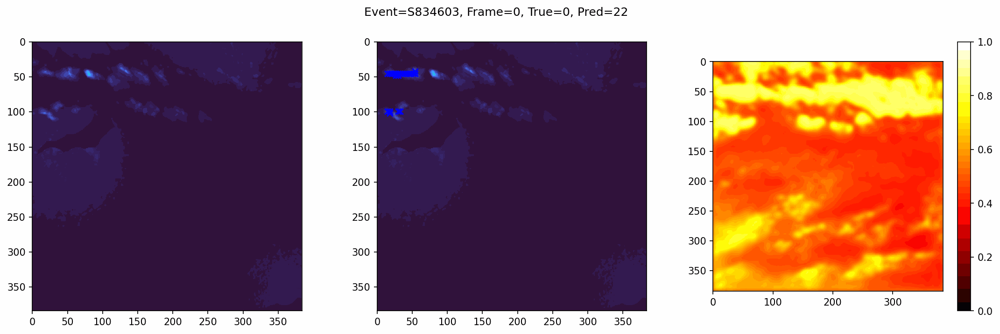

Vis storm S781158


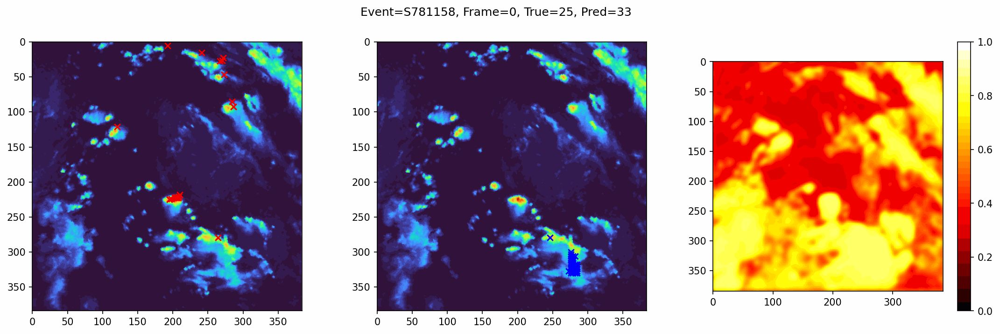

Vis storm S820524


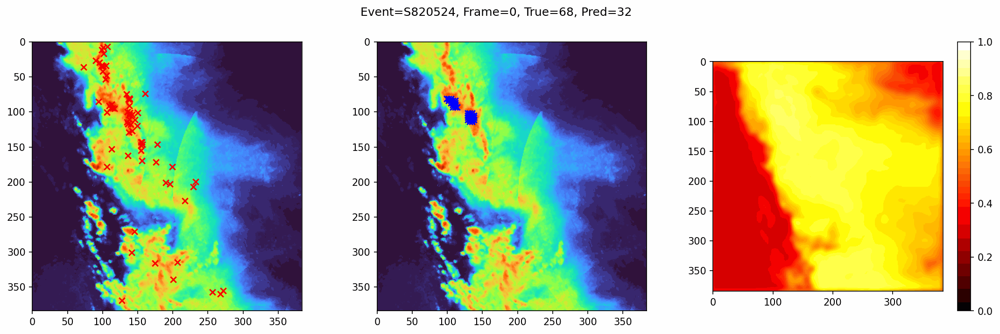

In [ ]:
if __name__=="__main__":
    torch.manual_seed(42)
    np.random.seed(42)
    sub_ids = get_subset_ids(df, fraction=0.3)
    train_ids, tmp_ids = train_test_split(sub_ids, test_size=0.4, random_state=42)
    val_ids, test_ids = train_test_split(tmp_ids, test_size=0.5, random_state=42)

    train_ds = LightningDataset(train_ids)
    val_ds   = LightningDataset(val_ids)
    test_ds  = LightningDataset(test_ids)
    train_loader = DataLoader(train_ds,batch_size=2,shuffle=True,collate_fn=custom_collate_fn)
    val_loader   = DataLoader(val_ds,batch_size=2,shuffle=False,collate_fn=custom_collate_fn)
    test_loader  = DataLoader(test_ds,batch_size=1,shuffle=False,collate_fn=custom_collate_fn)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = ConvLSTMModel(4,64)
    model = train_model(model, train_loader, val_loader, epochs=1, device=device)
    test_m = evaluate_model(model, test_loader, device=device)
    print("Test BCE+Count:", test_m)

    model.eval()
    tot_ch, nb = 0,0
    t_iter = iter(test_loader)
    for x_b,(mgt,cgt) in t_iter:
        ev_id = test_ds.event_ids[nb]
        ev_data = load_event(ev_id)
        c = compute_chamfer_for_batch(model, x_b, [ev_data['lght']], 0.3, device)
        print(f"Chamfer {ev_id}: {c:.2f}")
        tot_ch+=c; nb+=1
    if nb>0:
        print("Final Chamfer 3D:", tot_ch/nb)

    def visualise_event(eid):
        """
        Show single event pred vs GT
        """
        evd = load_event(eid)
        def proc(a):
            t = torch.from_numpy(a.transpose(2,0,1)).float()
            t = F.interpolate(t.unsqueeze(0),(128,128),mode='bilinear',align_corners=False).squeeze(0)
            return t
        vis   = proc(evd['vis']);   vis   = (vis - vis.mean())/(vis.std()+1e-6)
        ir69  = proc(evd['ir069']); ir69  = (ir69 - ir69.mean())/(ir69.std()+1e-6)
        ir107 = proc(evd['ir107']); ir107 = (ir107 - ir107.mean())/(ir107.std()+1e-6)
        vil   = proc(evd['vil']);   vil   = vil/255.

        vis,ir69,ir107,vil = vis.unsqueeze(1), ir69.unsqueeze(1), ir107.unsqueeze(1), vil.unsqueeze(1)
        x_in = torch.cat([vis,ir69,ir107,vil],1).unsqueeze(0).to(device)
        with torch.no_grad():
            pm,pc = model(x_in)
        visualise_comparison_with_probmap(eid, evd, pm.cpu(), pc.cpu(), output_gif=True, save_gif=False)

    test_list = list(test_ids)
    np.random.seed(9999)
    sam = np.random.choice(test_list,min(3,len(test_list)),replace=False)
    for eid in sam:
        print(f"Vis storm {eid}")
        visualise_event(eid)

save model

In [ ]:

torch.save(model.state_dict(), "my_trained_model.pth")
print("Model saved to my_trained_model.pth")

Optional Task - scaling law relationship between performance and compute

helper function to count parameters

In [ ]:
def count_parameters(model):
    """Count total trainable parameters"""
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [ ]:
def run_experiment(
    fraction=0.1,
    hidden_chans=32,
    batch_size=2,
    epochs=1,
    device='cuda'
):
    """
    Trains a ConvLSTMModel for the given hyperparams, returning:
      - final test loss
      - final chamfer distance
      - approximate compute
      - number of parameters
      - training set size (train_data_size)
    """

    # Subsample data
    sub_ids = get_subset_ids(df, fraction=fraction)

    # Split train/val/test
    train_ids, tmp_ids = train_test_split(sub_ids, test_size=0.4, random_state=42)
    val_ids,  test_ids = train_test_split(tmp_ids,  test_size=0.5, random_state=42)

    # Create datasets/loaders
    train_ds = LightningDataset(train_ids)
    val_ds   = LightningDataset(val_ids)
    test_ds  = LightningDataset(test_ids)

    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True,
                              collate_fn=custom_collate_fn)
    val_loader   = DataLoader(val_ds, batch_size=batch_size, shuffle=False,
                              collate_fn=custom_collate_fn)
    test_loader  = DataLoader(test_ds, batch_size=1, shuffle=False,
                              collate_fn=custom_collate_fn)

    # Create model
    model = ConvLSTMModel(in_chans=4, hidden_chans=hidden_chans).to(device)

    # Count parameters
    n_params = count_parameters(model)

    # Train model
    model = train_model(model, train_loader, val_loader, epochs=epochs, device=device)

    # Evaluate on test set
    test_m = evaluate_model(model, test_loader, device=device)
    final_test_loss = test_m['total_loss']

    # Compute average Chamfer
    chamfers = []
    for i, (x_b, (mgt, cgt)) in enumerate(test_loader):
        ev_id = test_ds.event_ids[i]
        ev_data = load_event(ev_id)
        ch = compute_chamfer_for_batch(model, x_b, [ev_data['lght']],
                                       threshold=0.3, device=device)
        chamfers.append(ch)
    mean_chamfer = float(np.mean(chamfers)) if len(chamfers)>0 else 0.0

    # Approximate total compute
    train_data_size = len(train_ds)
    steps_per_epoch = math.ceil(train_data_size / batch_size)
    total_steps     = epochs * steps_per_epoch
    approximate_compute = 6.0 * n_params * batch_size * total_steps

    return {
        'fraction': fraction,
        'hidden_chans': hidden_chans,
        'batch_size': batch_size,
        'epochs': epochs,
        'test_loss': final_test_loss,
        'chamfer': mean_chamfer,
        'n_params': n_params,
        'compute': approximate_compute,
        'train_data_size': train_data_size
    }

Running experiment with fraction=0.01, hidden=16, batch=2, epochs=1
ep0 b0 loss=332.5884 bce=2.7740 c=329.8145
ep0 trainLoss=286.5369 valLoss=147.0905
Running experiment with fraction=0.01, hidden=16, batch=2, epochs=2
ep0 b0 loss=18.9817 bce=2.7637 c=16.2181
ep0 trainLoss=17.6179 valLoss=17.9260
ep1 b0 loss=10.3303 bce=2.8378 c=7.4925
ep1 trainLoss=13.5991 valLoss=14.8765
Running experiment with fraction=0.01, hidden=16, batch=4, epochs=1
ep0 b0 loss=26.0478 bce=2.5522 c=23.4956
ep0 trainLoss=26.0478 valLoss=194.9075
Running experiment with fraction=0.01, hidden=16, batch=4, epochs=2
ep0 b0 loss=156.4006 bce=3.0485 c=153.3521
ep0 trainLoss=156.4006 valLoss=166.0647
ep1 b0 loss=156.3093 bce=2.9572 c=153.3521
ep1 trainLoss=156.3093 valLoss=166.0209
Running experiment with fraction=0.01, hidden=64, batch=2, epochs=1
ep0 b0 loss=338.1048 bce=2.6550 c=335.4498
ep0 trainLoss=307.6836 valLoss=341.3340
Running experiment with fraction=0.01, hidden=64, batch=2, epochs=2
ep0 b0 loss=369.9752 bc

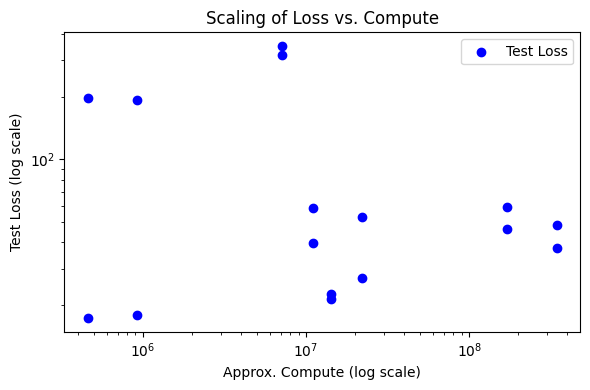

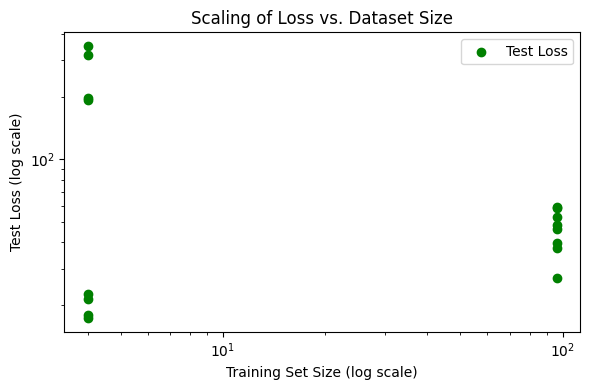

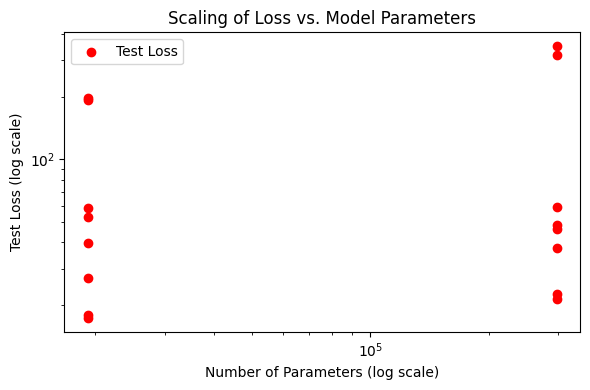

In [25]:
if __name__=="__main__":
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


    fractions     = [0.01, 0.2]  # vary dataset fraction
    hidden_sizes  = [16, 64]               # vary model size
    batch_sizes   = [2, 4]                 # vary batch size
    epoch_list    = [1, 2]                 # vary epochs

    records = []
    for (fr, hc, bs, ep) in itertools.product(fractions, hidden_sizes, batch_sizes, epoch_list):
        print(f"Running experiment with fraction={fr}, hidden={hc}, batch={bs}, epochs={ep}")
        res = run_experiment(
            fraction=fr,
            hidden_chans=hc,
            batch_size=bs,
            epochs=ep,
            device=device
        )
        records.append(res)

    #DataFrame
    df_scaling = pd.DataFrame(records)
    print(df_scaling)

    #Test Loss vs. Approx. Compute
    fig, ax = plt.subplots(1,1,figsize=(6,4))
    x = df_scaling['compute']
    y = df_scaling['test_loss']
    ax.scatter(x, y, c='blue', label='Test Loss')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel('Approx. Compute (log scale)')
    ax.set_ylabel('Test Loss (log scale)')
    ax.set_title('Scaling of Loss vs. Compute')
    ax.legend()
    plt.tight_layout()
    plt.show()

    #Test Loss vs. Dataset Size
    fig, ax = plt.subplots(figsize=(6,4))
    x = df_scaling['train_data_size']
    y = df_scaling['test_loss']
    ax.scatter(x, y, c='green', label='Test Loss')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel('Training Set Size (log scale)')
    ax.set_ylabel('Test Loss (log scale)')
    ax.set_title('Scaling of Loss vs. Dataset Size')
    ax.legend()
    plt.tight_layout()
    plt.show()

    #Test Loss vs. Number of Parameters
    fig, ax = plt.subplots(figsize=(6,4))
    x = df_scaling['n_params']
    y = df_scaling['test_loss']
    ax.scatter(x, y, c='red', label='Test Loss')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlabel('Number of Parameters (log scale)')
    ax.set_ylabel('Test Loss (log scale)')
    ax.set_title('Scaling of Loss vs. Model Parameters')
    ax.legend()
    plt.tight_layout()
    plt.show()